In [1]:
print("Ejercicio 3")

Ejercicio 3


In [2]:
# Importamos las librerías necesarias
import os
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio  # Para reproducir audio en el notebook
import soundfile as sf  
from scipy.signal import spectrogram,resample


# Definir el nombre del archivo de audio (asegúrate de tener este archivo)
archivo_estereo = 'viola_soundtrack.wav'

# Leemos el archivo de audio
# data contendrá el array con la señal, y samplerate la frecuencia de muestreo (en Hz)
data, samplerate = sf.read(archivo_estereo)

# Obtenemos el número de canales: si la señal tiene más de una dimensión, el segundo eje indica los canales
num_canales = data.shape[1] if data.ndim > 1 else 1

# Calculamos el tamaño del archivo en megabytes (Mb)
tamanio_bytes = os.path.getsize(archivo_estereo)
tamanio_mb = tamanio_bytes / (1024 ** 2)

# Mostramos las características del audio estéreo
print("Audio Estéreo:")
print("Frecuencia de muestreo:", samplerate, "Hz")
print("Número de canales:", num_canales)
print("Tamaño del archivo: {:.2f} Mb".format(tamanio_mb))



Audio Estéreo:
Frecuencia de muestreo: 44100 Hz
Número de canales: 2
Tamaño del archivo: 6.69 Mb


In [3]:
# Mostrar un widget para reproducir el audio estéreo
Audio(archivo_estereo)

In [4]:
# Si el audio es estéreo (más de un canal), se convierte a mono promediando los canales
if num_canales > 1:
    data_mono = np.mean(data, axis=1)  # Promediamos a lo largo del eje de canales
else:
    data_mono = data  # Si ya es mono, no se realiza ningún cambio

# Guardamos el audio mono en un nuevo archivo para poder reproducirlo
archivo_mono = 'viola_soundtrack_mono.wav'
sf.write(archivo_mono, data_mono, samplerate)

# Como la frecuencia de muestreo permanece igual y ahora solo tenemos un canal:
print("\nAudio Mono:")
print("Frecuencia de muestreo:", samplerate, "Hz")
print("Número de canales: 1")
# Para el tamaño del archivo mono, obtenemos el tamaño del nuevo archivo guardado
tamanio_mono_bytes = os.path.getsize(archivo_mono)
tamanio_mono_mb = tamanio_mono_bytes / (1024 ** 2)
print("Tamaño del archivo mono: {:.2f} Mb".format(tamanio_mono_mb))


Audio Mono:
Frecuencia de muestreo: 44100 Hz
Número de canales: 1
Tamaño del archivo mono: 3.35 Mb


In [5]:
print("\nReproducción del audio mono:")
Audio(archivo_mono)


Reproducción del audio mono:


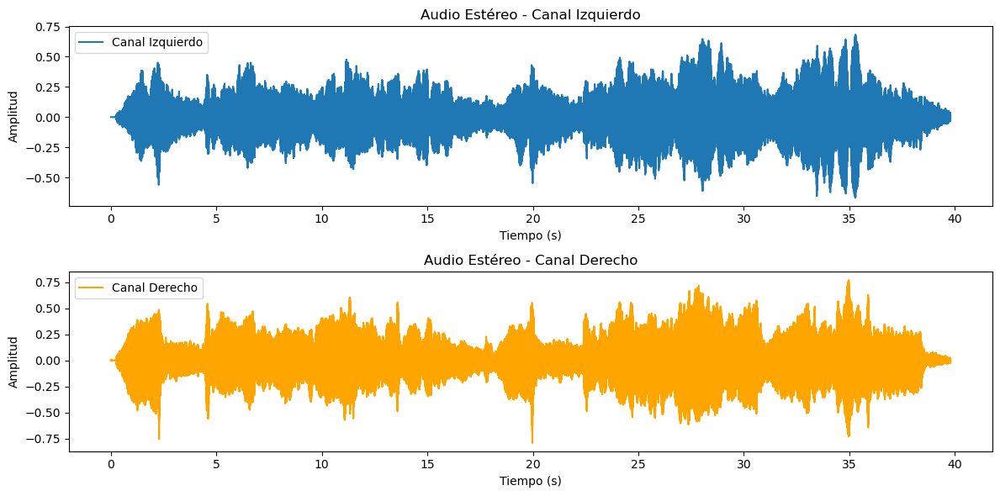

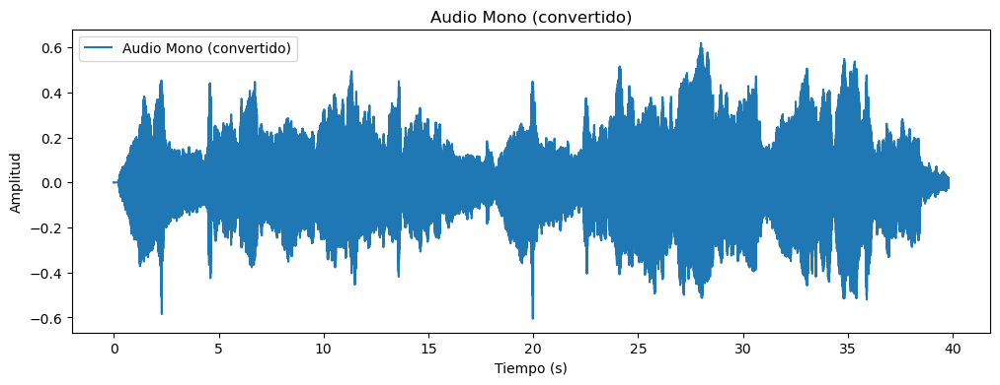

In [6]:
# Creamos un vector de tiempo basado en la duración del audio
tiempo_estereo = np.linspace(0, len(data) / samplerate, num=len(data))

# Graficamos los dos canales del audio estéreo por separado
if num_canales > 1:
    plt.figure(figsize=(12, 6))
    
    # Canal izquierdo
    plt.subplot(2, 1, 1)
    plt.plot(tiempo_estereo, data[:, 0], label='Canal Izquierdo')
    plt.title('Audio Estéreo - Canal Izquierdo')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    
    # Canal derecho
    plt.subplot(2, 1, 2)
    plt.plot(tiempo_estereo, data[:, 1], label='Canal Derecho', color='orange')
    plt.title('Audio Estéreo - Canal Derecho')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    
    plt.tight_layout()
    plt.show()
else:
    # Si el audio es mono, se grafica una sola señal
    plt.figure(figsize=(12, 4))
    plt.plot(tiempo_estereo, data, label='Audio Mono')
    plt.title('Audio Mono')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.show()

# Graficamos la señal mono convertida
tiempo_mono = np.linspace(0, len(data_mono) / samplerate, num=len(data_mono))
plt.figure(figsize=(12, 4))
plt.plot(tiempo_mono, data_mono, label='Audio Mono (convertido)')
plt.title('Audio Mono (convertido)')
plt.xlabel('Tiempo (s)')
plt.ylabel('Amplitud')
plt.legend()
plt.show()

In [7]:
print("Ejercicio 4")

Ejercicio 4


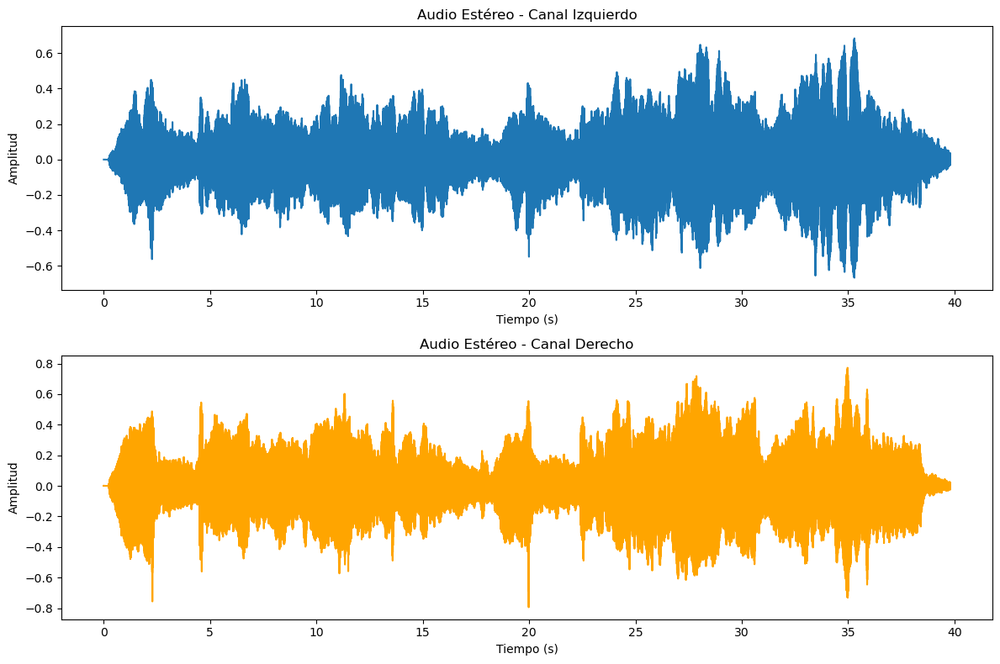

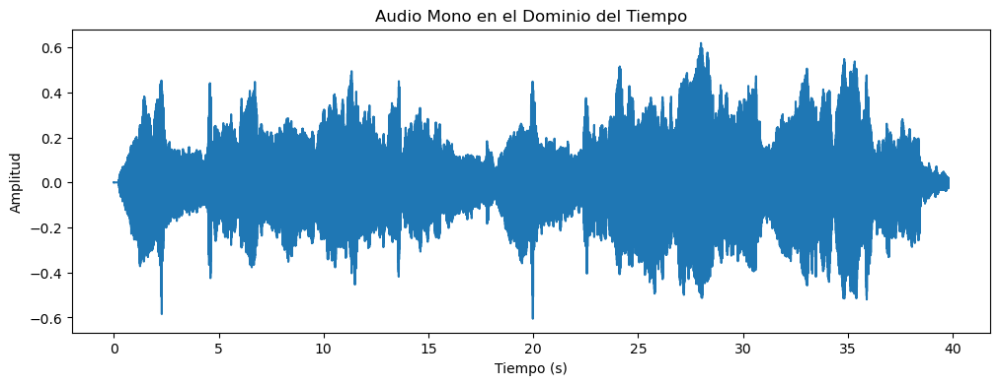

In [8]:
# Vector de tiempo para el audio estéreo y mono
tiempo_estereo = np.linspace(0, len(data)/samplerate, num=len(data))
tiempo_mono    = np.linspace(0, len(data_mono)/samplerate, num=len(data_mono))

# Gráfica para audio estéreo (separando canales si es estéreo)
if data.ndim > 1 and data.shape[1] > 1:
    plt.figure(figsize=(12,8))
    plt.subplot(2,1,1)
    plt.plot(tiempo_estereo, data[:,0])
    plt.title("Audio Estéreo - Canal Izquierdo")
    plt.xlabel("Tiempo (s)")
    plt.ylabel("Amplitud")
    
    plt.subplot(2,1,2)
    plt.plot(tiempo_estereo, data[:,1], color='orange')
    plt.title("Audio Estéreo - Canal Derecho")
    plt.xlabel("Tiempo (s)")
    plt.ylabel("Amplitud")
    
    plt.tight_layout()
    plt.show()
else:
    plt.figure(figsize=(12,4))
    plt.plot(tiempo_estereo, data)
    plt.title("Audio (Mono) en el Dominio del Tiempo")
    plt.xlabel("Tiempo (s)")
    plt.ylabel("Amplitud")
    plt.show()

# Gráfica para el audio mono
plt.figure(figsize=(12,4))
plt.plot(tiempo_mono, data_mono)
plt.title("Audio Mono en el Dominio del Tiempo")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.show()

In [9]:
print("Explicación de conceptos:")
print("• Frecuencia de muestreo: Número de muestras por segundo (Hz) que se toman para representar la señal.")
print("• Aliasing: Distorsión que ocurre cuando la frecuencia de muestreo es insuficiente, causando que las altas frecuencias se malinterpreten como bajas.")
print("• Profundidad de bits: Número de bits usados para cuantificar cada muestra; determina la precisión y el rango dinámico del audio.")
print("• Ancho de banda: Rango de frecuencias que puede reproducir o transmitir el audio de forma efectiva.")
print("• Tasa de bits (bitrate): Cantidad de datos (en bits) que se transmiten o almacenan por segundo, influye en la calidad del audio.")

Explicación de conceptos:
• Frecuencia de muestreo: Número de muestras por segundo (Hz) que se toman para representar la señal.
• Aliasing: Distorsión que ocurre cuando la frecuencia de muestreo es insuficiente, causando que las altas frecuencias se malinterpreten como bajas.
• Profundidad de bits: Número de bits usados para cuantificar cada muestra; determina la precisión y el rango dinámico del audio.
• Ancho de banda: Rango de frecuencias que puede reproducir o transmitir el audio de forma efectiva.
• Tasa de bits (bitrate): Cantidad de datos (en bits) que se transmiten o almacenan por segundo, influye en la calidad del audio.


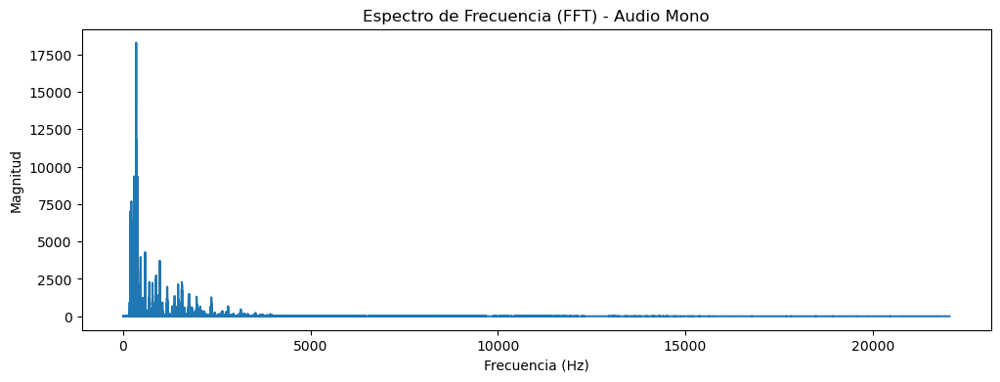

La FFT transforma la señal del dominio del tiempo al dominio de la frecuencia, permitiendo identificar las componentes frecuenciales que forman el audio.


In [10]:
fft_data = np.fft.fft(data_mono)  # Realiza la FFT
fft_freq = np.fft.fftfreq(len(data_mono), d=1/samplerate)  # Obtiene el vector de frecuencias

# Nos quedamos solo con las frecuencias positivas
indices_positivos = fft_freq >= 0
fft_freq = fft_freq[indices_positivos]
fft_magnitude = np.abs(fft_data)[indices_positivos]

plt.figure(figsize=(12,4))
plt.plot(fft_freq, fft_magnitude)
plt.title("Espectro de Frecuencia (FFT) - Audio Mono")
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Magnitud")
plt.show()

print("La FFT transforma la señal del dominio del tiempo al dominio de la frecuencia, permitiendo identificar las componentes frecuenciales que forman el audio.")

In [11]:
# Se calcula el espectrograma usando scipy.signal.spectrogram
f, t_spec, Sxx = spectrogram(data_mono, fs=samplerate, nperseg=1024, noverlap=512)

# La energía en cada banda de frecuencia se obtiene sumando a lo largo del tiempo
energia_por_frecuencia = np.sum(Sxx, axis=1)
energia_total = np.sum(energia_por_frecuencia)

# Elegimos epsilon como el 90% de la energía total (puedes probar con otros valores)
epsilon = 0.9 * energia_total

# Calculamos la energía acumulada y buscamos la frecuencia de corte
energia_acumulada = np.cumsum(energia_por_frecuencia)
indice_corte = np.where(energia_acumulada >= epsilon)[0][0]
frecuencia_corte = f[indice_corte]

print("Frecuencia de corte (90% de la energía): {:.2f} Hz".format(frecuencia_corte))

Frecuencia de corte (90% de la energía): 990.53 Hz


In [12]:
# El factor de downsampling se calcula a partir de la razón entre la frecuencia de muestreo original y la frecuencia de corte
factor_downsampling = samplerate / frecuencia_corte
# Se redondea al entero más cercano
factor_downsampling = int(round(factor_downsampling))
print("Factor de downsampling:", factor_downsampling)

# Aplicar downsampling tomando cada 'n'-ésima muestra
data_comprimida = data_mono[::factor_downsampling]
samplerate_comprimida = int(samplerate / factor_downsampling)

Factor de downsampling: 45


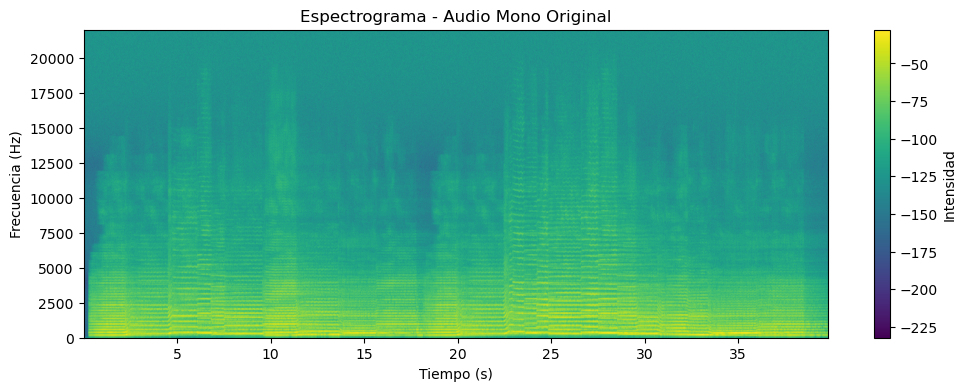

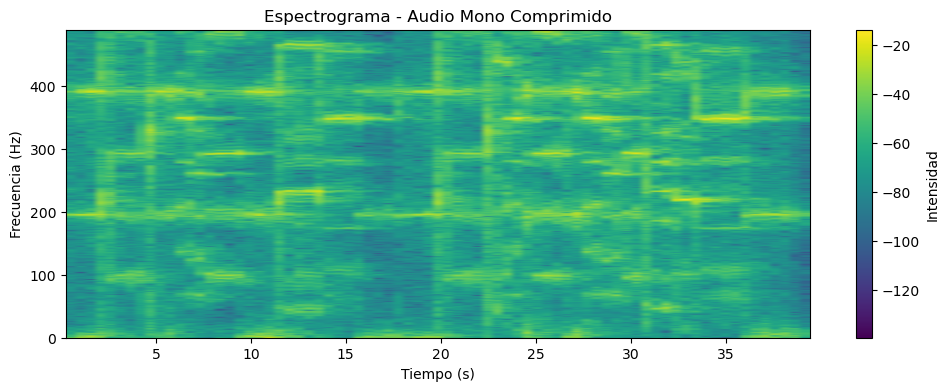

El espectrograma del audio comprimido muestra menor resolución en tiempo y frecuencia, ya que se han perdido muestras tras el downsampling, lo que puede afectar la fidelidad de las altas frecuencias.


In [13]:
# Espectrograma del audio mono original
plt.figure(figsize=(12,4))
plt.specgram(data_mono, NFFT=1024, Fs=samplerate, noverlap=512)
plt.title("Espectrograma - Audio Mono Original")
plt.xlabel("Tiempo (s)")
plt.ylabel("Frecuencia (Hz)")
plt.colorbar(label="Intensidad")
plt.show()

# Espectrograma del audio mono comprimido
plt.figure(figsize=(12,4))
plt.specgram(data_comprimida, NFFT=1024, Fs=samplerate_comprimida, noverlap=512)
plt.title("Espectrograma - Audio Mono Comprimido")
plt.xlabel("Tiempo (s)")
plt.ylabel("Frecuencia (Hz)")
plt.colorbar(label="Intensidad")
plt.show()

print("El espectrograma del audio comprimido muestra menor resolución en tiempo y frecuencia, ya que se han perdido muestras tras el downsampling, lo que puede afectar la fidelidad de las altas frecuencias.")


In [14]:
archivo_mono = 'viola_soundtrack_mono.wav'
archivo_comprimido = 'viola_soundtrack_comprimido.wav'

# Guardar el audio mono original
sf.write(archivo_mono, data_mono, samplerate)
# Guardar el audio comprimido
sf.write(archivo_comprimido, data_comprimida, samplerate_comprimida)

tamano_mono = os.path.getsize(archivo_mono) / (1024**2)
tamano_comprimido = os.path.getsize(archivo_comprimido) / (1024**2)
print("Tamaño del audio mono original: {:.2f} Mb".format(tamano_mono))
print("Tamaño del audio mono comprimido: {:.2f} Mb".format(tamano_comprimido))


Tamaño del audio mono original: 3.35 Mb
Tamaño del audio mono comprimido: 0.07 Mb


In [15]:
print("Reproducción del audio mono original:")
Audio(archivo_mono)



Reproducción del audio mono original:


In [18]:
# Re-muestreamos la señal comprimida para que tenga la misma duración que el original.
# Calculamos el número de muestras que debería tener el audio para reproducirse con la misma duración
num_samples_original = len(data_mono)
# Resampleamos data_comprimida (que tiene len(data_mono)//factor_downsampling muestras)
data_comprimida_upsampled = resample(data_comprimida, num_samples_original)

# Ahora reproducimos el audio re-muestreado a la frecuencia original para poder escucharlo
print("Reproducción del audio mono comprimido (upsampled para reproducción):")
display(Audio(data_comprimida_upsampled, rate=samplerate))

Reproducción del audio mono comprimido (upsampled para reproducción):
